## Import Necessary Libraries

In [1]:
import os
import glob
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import IPython.display as ipd
import librosa, librosa.display
import re
import itertools
%matplotlib inline

import sys
sys.path.append('..')
import libfmp.c3, libfmp.b

## Curious Insights

Stable Audio on Hugging Face gives the same music for the same prompt! Is this normal? And if yes, why? How does this affect GenAI models given copyright and piracy issues!! For example, if I sample a vector from the latent space of a VAE, if there is no element of randomness and given that the weights of the decoder are fixed, won't the same result be generated every time? What is the impact of this?

Here is a sample prompt used: "Jazz 120 BPM" </br>
Result from my chrome browser:

In [2]:
ipd.Audio("jazz_120_chrome.wav")

Result from my edge browser:

In [3]:
ipd.Audio("jazz_120_edge.wav")

Here is another sample prompt used: "violin 120BPM" </br>
Result from my chrome browser:

In [4]:
ipd.Audio("violin_120BPM_chrome.wav")

Result from my edge browser:

In [5]:
ipd.Audio("violin_120BPM_Edge.wav")

## Define Core Functions

In [6]:
def feature_extraction(file1: str, file2:str, feature="mfcc") -> None:
    """ 
        Loads two different files and 
        returns their mid-level feature
        representation
    """
    Fs = 22050

    X_wav, Fs = librosa.load(file1, sr=Fs)
    Y_wav, Fs = librosa.load(file2, sr=Fs)

    if feature == "mfcc":
        n_mfcc = 13  # Number of MFCCs to extract
        X= librosa.feature.mfcc(y=X_wav, sr=Fs, n_mfcc=n_mfcc)
        Y= librosa.feature.mfcc(y=Y_wav, sr=Fs, n_mfcc=n_mfcc)
    else:
        N, H = 4410, 2205
        X = librosa.feature.chroma_stft(y=X_wav, sr=Fs, tuning=0, norm=2, hop_length=H, n_fft=N)
        Y = librosa.feature.chroma_stft(y=Y_wav, sr=Fs, tuning=0, norm=2, hop_length=H, n_fft=N)
    
    return X, Y


In [7]:
def dtw_compute(X, Y):
    """ 
        Computes the DTW and returns
        the cost matrix, acc. cost matrix
        and optimal warping path.

        Arguments
        ---------
            X: feature representation of the first signal
            Y: feature representation of the second signal

        Returns
        -------
            C (cost matrix), D (acc. cost matrix), P (optimal warping path)
    """
    C = libfmp.c3.compute_cost_matrix(X, Y)
    D = libfmp.c3.compute_accumulated_cost_matrix(C)
    P = libfmp.c3.compute_optimal_warping_path(D)
    return C, D, P
    

In [8]:
def plot_costs(C, D, P) -> None:
    """ 
        Plots the cost matrix and 
        acc. cost matrix while showing 
        the optimal warping path.

        Arguments
        ---------
            C: cost matrix
            D: acc. cost matrix
            P: optimal warping path

        Returns
        -------
            None
    """
    plt.figure(figsize=(12, 3))
    ax = plt.subplot(1, 2, 1)
    libfmp.c3.plot_matrix_with_points(C, P, linestyle='-',  marker='', 
    ax=[ax], aspect='equal', clim=[0, np.max(C)], 
    title='$C$ with optimal warping path', xlabel='Sequence Y', ylabel='Sequence X');

    ax = plt.subplot(1, 2, 2)
    libfmp.c3.plot_matrix_with_points(D, P, linestyle='-', marker='', 
    ax=[ax], aspect='equal', clim=[0, np.max(D)], 
    title='$D$ with optimal warping path', xlabel='Sequence Y', ylabel='Sequence X');

    plt.tight_layout()

In [9]:
def show_alignment(X, Y, P) -> None:
    """ 
        Shows the alignment between X and Y

        Arguments
        ---------
            X: feature representation of the first signal
            Y: feature representation of the second signal

        Returns
        -------
            None
    """
    N = X.shape[1]
    M = Y.shape[1]
    H = 2205

    plt.figure(figsize=(8, 3))
    #plt.figure(figsize=(5, 3)) 
    ax_X = plt.axes([0, 0.60, 1, 0.40])
    librosa.display.specshow(X, ax=ax_X, x_axis='frames', y_axis='chroma', cmap='gray_r', hop_length=H)
    ax_X.set_ylabel('Sequence X')
    ax_X.set_xlabel('Time (frames)')
    ax_X.xaxis.tick_top()
    ax_X.xaxis.set_label_position('top') 

    ax_Y = plt.axes([0, 0, 1, 0.40])
    librosa.display.specshow(Y, ax=ax_Y, x_axis='frames', y_axis='chroma', cmap='gray_r', hop_length=H)
    ax_Y.set_ylabel('Sequence Y')
    ax_Y.set_xlabel('Time (frames)')

    step = 5
    y_min_X, y_max_X = ax_X.get_ylim()
    y_min_Y, y_max_Y = ax_Y.get_ylim()
    for t in P[0:-1:step, :]: 
        ax_X.vlines(t[0], y_min_X, y_max_X, color='r')
        ax_Y.vlines(t[1], y_min_Y, y_max_Y, color='r')

    ax = plt.axes([0, 0.40, 1, 0.20])
    for p in P[0:-1:step, :]: 
        ax.plot((p[0]/N, p[1]/M), (1, -1), color='r')
        ax.set_xlim(0, 1)
        ax.set_ylim(-1, 1)
    ax.set_xticks([])
    ax.set_yticks([]);

In [10]:
def alignment_cost(C, P):
    """ 
        Returns the alignment cost
        in the cost matrix
    """
    max_cost = np.max(C)
    return max_cost

## Function Testing

Test all the defined functions to see if they work smoothly!</br>
Also plot graphs to show if it confirms previous experiments

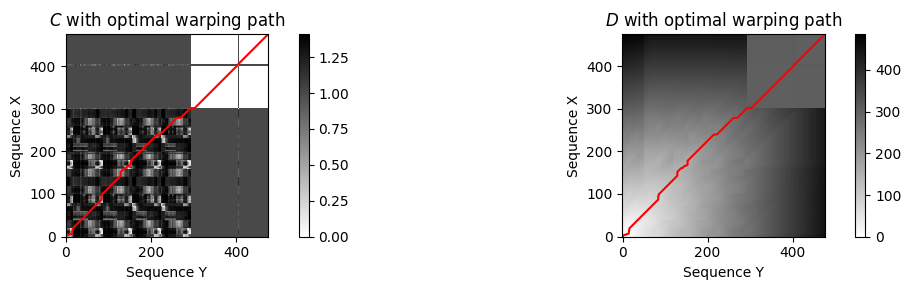

In [11]:
file1 = fn_wav_X = os.path.join('..', 'data', 'Classical', 'Classical_Piano_120.wav')
file2 = os.path.join('..', 'data', 'Classical', 'Classical_Piano_140.wav')

X, Y = feature_extraction(file1, file2, feature="chromagram")
C, D, P = dtw_compute(X, Y)
plot_costs(C, D, P)

The alignment cost is: 1.4084863927227451


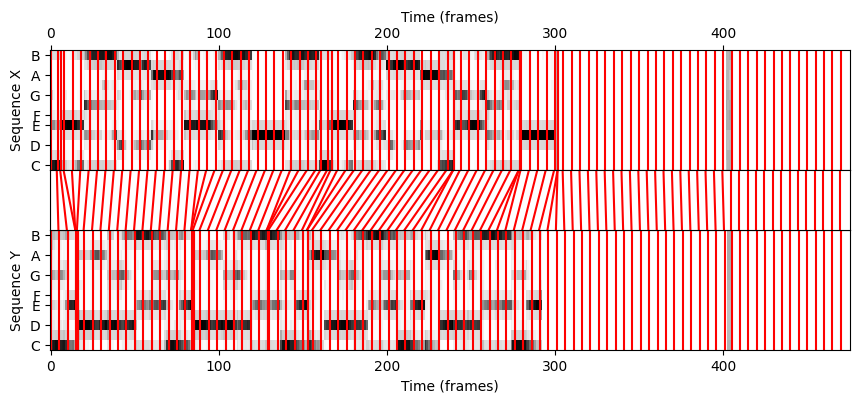

In [13]:
max_cost = alignment_cost(C, P)
print(f"The alignment cost is: {max_cost}")
show_alignment(X, Y, P)

## Analysis of Classical, Pop and Jazz Piano Music From Stable Audio Open Diffusion Model

In [14]:
# Get all files for jazz, classical and piano
jazz_files = sorted(glob.glob(os.path.join('..', 'data', 'Jazz', '*.wav')))
class_files = sorted(glob.glob(os.path.join('..', 'data', 'Classical', '*.wav')))
pop_files = sorted(glob.glob(os.path.join('..', 'data', 'Pop', '*.wav')))
print(pop_files)

['..\\data\\Pop\\Pop_Piano_120.wav', '..\\data\\Pop\\Pop_Piano_140.wav', '..\\data\\Pop\\Pop_Piano_160.wav', '..\\data\\Pop\\Pop_Piano_180.wav', '..\\data\\Pop\\Pop_Piano_200.wav']


### For each genre, get the costs and depict them

```
Note that the cost used in this case is the maximum cost and not the alignment cost.
```

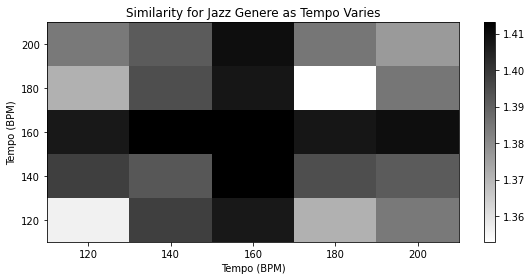

In [15]:
# Jazz genre
# Create table
dict_jazz = {'120': None, '140': None, '160': None, '180': None, '200': None}
pd_jazz = pd.DataFrame(dict_jazz, index = ['120', '140', '160', '180', '200'])

combs = list(itertools.product(jazz_files, jazz_files))

for idx, (i,j) in enumerate(combs):
    X, Y = feature_extraction(i, j, feature="chromagram")
    C, D, P = dtw_compute(X, Y)
    max_cost = alignment_cost(C, P)

    i_name = re.search(r'(\d+)', i).group(1)
    j_name = re.search(r'(\d+)', j).group(1)

    # Fill in the table
    pd_jazz.loc[i_name, j_name] = max_cost


pd_jazz_numpy = pd_jazz.to_numpy(dtype = float)
#half_pd_jazz_numpy = np.tril(pd_jazz_numpy)
#half_pd_jazz_numpy = np.where(half_pd_jazz_numpy == 0, np.min(pd_jazz_numpy), half_pd_jazz_numpy)


fig, ax, im = libfmp.b.plot_matrix(pd_jazz_numpy, title = "Similarity for Jazz Genere as Tempo Varies", xlabel = "Tempo (BPM)", \
    ylabel = "Tempo (BPM)", figsize=(8, 4), T_coef = [120, 140, 160, 180, 200],\
        F_coef = [120, 140, 160, 180, 200])

### Notes for the Jazz Genre ###
```
For each BPM, the colour increases and decreases when compared to other 
BPMs (look at the vertical color pattern changes: bottom to the top). 

A weird thing to note is that this effect increases as you move on the 
x axis. Which means as the BPM increases, the cost becomes higher.
However, this dissimilarity increases up to 160 BPM and decreases after
that. 

So, 160 BPM seems to be a defining point however you look at the chart...

180 BPM seems to be the only anomaly in this pattern. The color increases
and rather than decrease linearly, there is a disruption at (180, 180) 
which shows a large level of similarity when considering the max cost.

Across the diagonal, there is a general increase and decrease with 160BPM
also as the defining point. Since the chart is symmetric, we can look at it
for what it is. Doing this, however, reveals these subtle patterns with 
160 BPM as a focal point and 180 BPM as an anpmaly!!
```

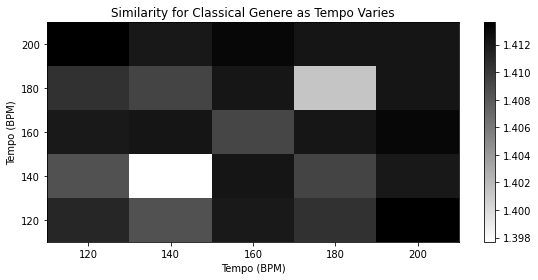

In [16]:
# Classical genre
# Create table
dict_class = {'120': None, '140': None, '160': None, '180': None, '200': None}
pd_class = pd.DataFrame(dict_class, index = ['120', '140', '160', '180', '200'])

combs = list(itertools.product(class_files, class_files))

for idx, (i,j) in enumerate(combs):
    X, Y = feature_extraction(i, j, feature="chromagram")
    C, D, P = dtw_compute(X, Y)
    max_cost = alignment_cost(C, P)

    i_name = re.search(r'(\d+)', i).group(1)
    j_name = re.search(r'(\d+)', j).group(1)

    # Fill in the table
    pd_class.loc[i_name, j_name] = max_cost


pd_class_numpy = pd_class.to_numpy(dtype = float)

fig, ax, im = libfmp.b.plot_matrix(pd_class_numpy, title = "Similarity for Classical Genere as Tempo Varies", xlabel = "Tempo (BPM)", \
    ylabel = "Tempo (BPM)", figsize=(8, 4), T_coef = [120, 140, 160, 180, 200],\
        F_coef = [120, 140, 160, 180, 200])

### Notes for the Classical Genre ###
```
Here we have an interesting behavioural pattern looking vertically: decrease - increase - decrease. 
Unfortunately, 160 BPM seems to be the disruptor. It is: increase - decrease - increase!
```

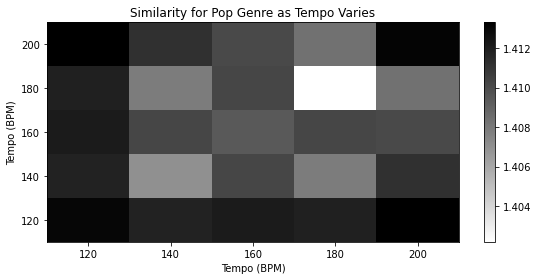

In [17]:
# Pop genre
# Create table
dict_pop = {'120': None, '140': None, '160': None, '180': None, '200': None}
pd_pop = pd.DataFrame(dict_pop, index = ['120', '140', '160', '180', '200'])

combs = list(itertools.product(pop_files, pop_files))

for idx, (i,j) in enumerate(combs):
    X, Y = feature_extraction(i, j, feature="chromagram")
    C, D, P = dtw_compute(X, Y)
    max_cost = alignment_cost(C, P)

    i_name = re.search(r'(\d+)', i).group(1)
    j_name = re.search(r'(\d+)', j).group(1)

    # Fill in the table
    pd_pop.loc[i_name, j_name] = max_cost


pd_pop_numpy = pd_pop.to_numpy(dtype = float)

fig, ax, im = libfmp.b.plot_matrix(pd_pop_numpy, title = "Similarity for Pop Genre as Tempo Varies", xlabel = "Tempo (BPM)", \
    ylabel = "Tempo (BPM)", figsize=(8, 4), T_coef = [120, 140, 160, 180, 200],\
        F_coef = [120, 140, 160, 180, 200])

### Notes for the Pop Genre ###
```
Virtually all BPMS (reading vertically) follow the pattern of decrease - increase - decrease.
Interestingly, again, 160 BPM seems to be a big disruptor!
```

## Summary

For each genre, we see obvious patterns that govern the behaviour of the latent space. For the given prompt: "Genre X BPM" where X denotes the BPM value, we see that 160 BPM seems to be an interesting point in the latent space. One thing is clear: for us to build robust generative music systems, we need to be able to factorize the latent space to explain how the model works. Doing this will give rise to more tunable systems that can achieve the effect a creative wants! </br>

One thing is clear though even if it has not been tested: it is hard to see how these audio samples follow a given BPM if indicated in the prompt!

### Average Cost per Genre

In [18]:
class_avg = np.mean(np.triu(pd_class_numpy))
pop_avg = np.mean(np.triu(pd_pop_numpy))
jazz_avg = np.mean(np.triu(pd_jazz_numpy))

print(f"The average cost for Jazz is: {round(jazz_avg, 4)}")
print(f"The average cost for Classical is: {round(class_avg, 4)}")
print(f"The average cost for Pop is: {round(pop_avg, 4)}")

The average cost for Jazz is: 0.8342
The average cost for Classical is: 0.8459
The average cost for Pop is: 0.8461


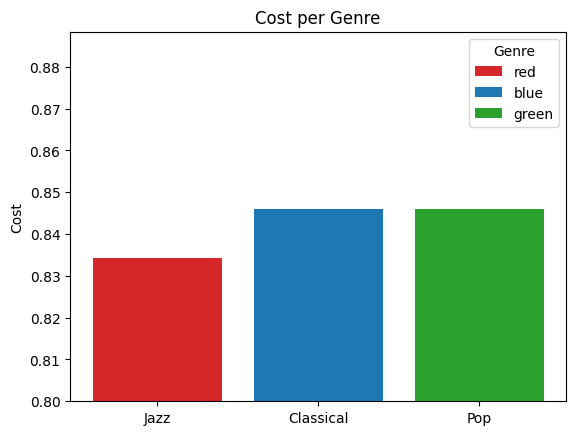

In [19]:
fig, ax = plt.subplots()
genres = ['Jazz', 'Classical', 'Pop']
gen_vals = [jazz_avg, class_avg, pop_avg]
bar_labels = ['red', 'blue', 'green']
bar_colors = ['tab:red', 'tab:blue', 'tab:green']

ax.bar(genres, gen_vals, label = bar_labels, color = bar_colors)
ax.set_ylabel('Cost')
ax.set_title('Cost per Genre')
ax.legend(title='Genre')
ax.set_ylim(0.8)
plt.show()